In [3]:
from typing import Tuple

import jax
import jax.random as random
import numpy as np
import jax.numpy as jnp
from jax import random
import plotly.graph_objects as go
import matplotlib.pyplot as plt

In [4]:
def variance_plot(
    mean: float, 
    std: float, 
    main_rng: jax.random.PRNGKey,
    figsize=(6, 3)
):
    fig = plt.figure(figsize=figsize)

    X = random.normal(main_rng, (1000,)) * std + mean

    X_sq = X ** 2
    plt.hist(X, bins=100, alpha=0.5, log=True);
    plt.hist(X_sq, bins=100, alpha=0.5, log=True);

    E_X = jnp.mean(X)
    plt.axvline(E_X, color='red', linestyle='dashed', linewidth=2, label=f'E[X] = {E_X: .4f}')

    E_X_sq = jnp.mean(X_sq)
    plt.axvline(E_X_sq, color='blue', linestyle='dashed', linewidth=2, label=f'E[X^2] = {E_X_sq: .4f}')

    plt.axvline(E_X ** 2, color='green', linestyle='dashed', linewidth=2, label=f'E[X]^2 = {E_X ** 2: .4f}')

    # draw a horizonta arrow between E_X^2 and E_X_sq
    plt.annotate(
        '', 
        xy=(E_X_sq, mean), 
        xytext=(E_X ** 2, mean),
        arrowprops=dict(arrowstyle='<->')
    )
    
    plt.text(
        (E_X_sq + E_X ** 2) / 2, 
        mean + 2, 
        'Var(X) = E[X^2] - E[X]^2', 
        horizontalalignment='center', 
        verticalalignment='center'
    )
    
    plt.title(f"Mean: {mean}, Std: {std}")
    
    # clip x-axis range to be at most 500
    plt.xlim(-10, 500)
    
    plt.legend();

    return fig

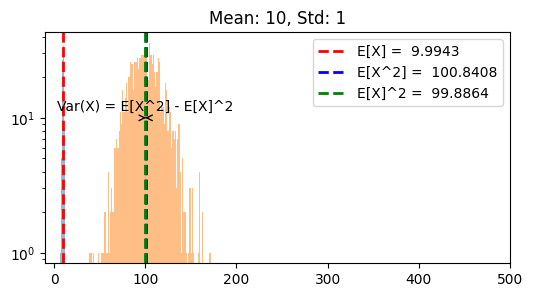

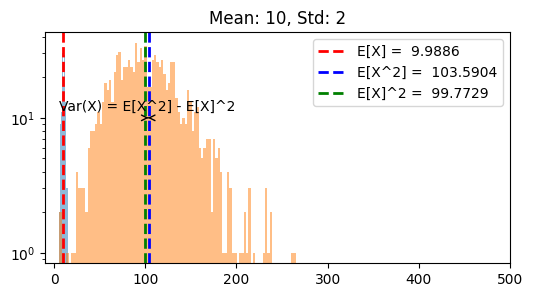

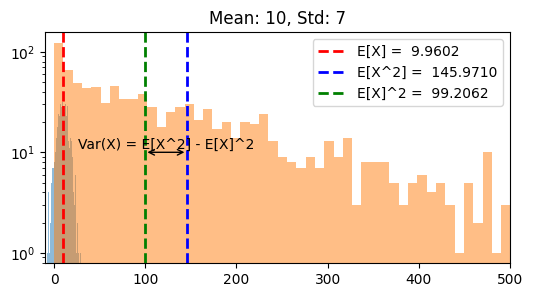

In [8]:
figures = []
main_rng = random.PRNGKey(0)
for std in [1, 2, 7]:
    figures.append(variance_plot(10, std, main_rng))


In [2]:
# Data generation function
def generate_data(
    rng_key: jax.random.PRNGKey,
    mean: float,
    std_value: float,
    n_samples: int = 5000
) -> Tuple[jax.Array, jax.Array]:
    X = random.normal(rng_key, (n_samples,)) * std_value + mean
    X_squared = X**2
    return X, X_squared


# Define the range and values for std
std_values = np.arange(0.5, 50, 0.5)
mean = 10
rng_key = random.PRNGKey(0)

# Generate data for each std value
data = [generate_data(rng_key, mean, std) for std in std_values]

# Create traces for X and X squared
traces = []
for i, (X, X_squared) in enumerate(data):
    visible = i == 0  # Only show the first dataset by default
    traces.append(go.Histogram(x=X, opacity=0.5, name=f'X (std={std_values[i]:.1f})', marker=dict(color='blue'), visible=visible))
    traces.append(go.Histogram(x=X_squared, opacity=0.5, name=f'X^2 (std={std_values[i]:.1f})', marker=dict(color='red'), visible=visible))

    # Add vertical line for E[X]
    traces.append(go.Scatter(x=[mean, mean], y=[0, max(np.histogram(X_squared, bins=100)[0])],
                             line=dict(color='blue', dash='dash'), visible=visible, name='E[X]'))

    # Add vertical line for E[X^2]
    EX2 = np.mean(X_squared)
    traces.append(go.Scatter(x=[EX2, EX2], y=[0, max(np.histogram(X_squared, bins=100)[0])],
                             line=dict(color='red', dash='dash'), visible=visible, name='E[X^2]'))

    # Add vertical line for (E[X])^2
    EX_squared = mean**2
    traces.append(go.Scatter(x=[EX_squared, EX_squared], y=[0, max(np.histogram(X_squared, bins=100)[0])],
                             line=dict(color='green', dash='dash'), visible=visible, name='(E[X])^2'))

# Define steps for the slider
steps = []
for i, std in enumerate(std_values):
    step = {
        'args': [
            {'visible': [j == i for j in range(len(std_values)) for _ in range(5)]},  # Note the range change here for 5 traces
            {'title': f'Std: {std}'}
        ],
        'label': str(std),
        'method': 'update'
    }
    steps.append(step)

# Define slider
sliders = [{
    'active': 0,
    'yanchor': 'top',
    'xanchor': 'left',
    'currentvalue': {
        'font': {'size': 20},
        'prefix': 'Std:',
        'visible': True,
        'xanchor': 'right'
    },
    'transition': {'duration': 300, 'easing': 'cubic-in-out'},
    'pad': {'b': 10, 't': 50},
    'len': 0.9,
    'x': 0.1,
    'y': 0,
    'steps': steps
}]

# Create the figure and add traces
fig = go.Figure(data=traces)

# Update layout for the slider and title
fig.update_layout(
    sliders=sliders,
    barmode='overlay',
    yaxis_type="log",  # Set y-axis to log scale
    title='Distributions of X and X^2'
)

# Show figure
fig.show()